# USGS 3DHP

In [1]:
from pynhd import HP3D, NLDI
import shapely

USGS 3DHP web service has five layers: `hydrolocation`, `flowline`, `waterbody`, `drainage_area`, and `catchment`. Let's start by getting the closest flowline within a 10 m radius of a point.

In [2]:
nhd3d = HP3D("flowline")
point = shapely.Point(-89.441, 43.487)
flw = nhd3d.bygeom(point, distance=10)
flw.explore()

Next, we use `NLDI` to get the basin boundary of a NHD flowline and use it to query different layers of the 3DHP web service.

In [3]:
comid = "937070225"
basin = NLDI().get_basins(comid, "comid")
basin.explore()

In [4]:
nhd3d = HP3D("flowline")
network = nhd3d.bygeom(basin.geometry[0])
network.explore()

In [5]:
nhd3d = HP3D("waterbody")
water = nhd3d.bygeom(basin.geometry[0])
water.explore()

In [6]:
nhd3d = HP3D("hydrolocation")
hydrolocation = nhd3d.bygeom(basin.geometry[0])
hydrolocation.explore()

We can also query the service using mainstems.

In [7]:
dm = ('https://geoconnex.us/ref/mainstems/323742', 'https://geoconnex.us/ref/mainstems/312091')
nhd3d = HP3D("flowline")
down_mains = nhd3d.byids("mainstemid", dm)
down_mains.explore()

Or using NHD ReachCode.

In [8]:
reachcode = "07070004002889"
nhd3d = HP3D("hydrolocation")
hydrolocation = nhd3d.byids("universalreferenceid", reachcode)
hydrolocation

,geometry,OBJECTID,id3dhp,featuredate,mainstemid,universalreferenceid,gnisid,gnisidlabel,featuretype,featuretypelabel,edhuniqueid,workunitid
0,POINT (-89.44179 43.48829),5800707,01HAJW7,1694649600000,https://geoconnex.us/ref/mainstems/359842,07070004002889,None,None,10,Reachcode Start,None,None
1,POINT (-89.43904 43.48568),25271902,01SVVYQ,1694649600000,https://geoconnex.us/ref/mainstems/359842,07070004002889,None,None,11,Reachcode End,None,None


Let's query flowlines and hydrolocations for a list of mainstems.

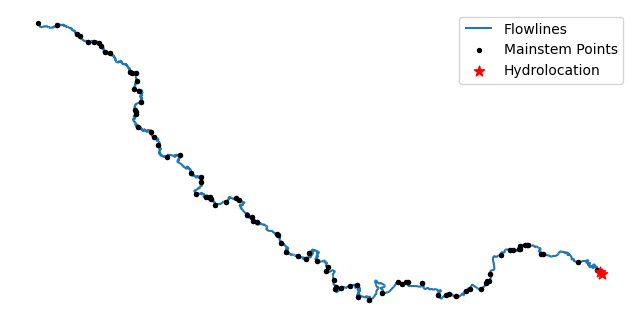

In [9]:
nhd3d = HP3D("hydrolocation")
mainstem_points = nhd3d.byids("mainstemid", hydrolocation["mainstemid"].to_list())
nhd3d = HP3D("flowline")
mainstem_lines = nhd3d.byids("mainstemid", hydrolocation["mainstemid"].to_list())
ax = mainstem_lines.plot(zorder=0, figsize=(8, 8))
mainstem_points.plot(ax=ax, color="k", markersize=8)
hydrolocation.plot(ax=ax, color="r", markersize=60, marker="*")
ax.legend(["Flowlines", "Mainstem Points", "Hydrolocation"])
ax.set_axis_off()